In [13]:
import glob, json, logging, os, skimage.color, skimage.draw, skimage.io, sys, utils, visualize
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from collections import defaultdict, Counter
from jsonmerge import merge

In [14]:
%matplotlib inline

In [15]:
model_training_path = '/mnt/ntfisheriesstoreeastdev/modeltraining'

### List Training Datasets

In [16]:
def print_list(l):
    for item in l:
        print(item)

In [17]:
folders = []

for dirpath, dirnames, filenames in os.walk(model_training_path):
    if dirnames and not dirpath == model_training_path:
        folders.append(dirpath)

folders = list(reversed(folders))

print('Training Datasets:')

training_datasets = [folder.split('/')[-1] for folder in folders]

print_list(training_datasets)

Training Datasets:
201807240204


### Set Training Dataset

In [18]:
dataset = '201807240204'
test_dataset = 'test'

In [19]:
dataset_path = os.path.join(model_training_path, dataset)

In [20]:
class CustomDataset(utils.Dataset):

    def load_frames(self, class_names, dataset_path, subset, region_data_json):
        for class_name in class_names:
            self.add_class("custom", class_name, str(class_name))

        assert subset in ["train", "validate"]
        
        annotations = json.load(open(os.path.join(dataset_path, region_data_json)))
        annotations = list(annotations.values()) # don't need the dict keys
        
        # The VIA tool saves images in the JSON even if they don't have any
        # annotations. Skip unannotated images.
        annotations = [annotation for annotation in annotations if annotation['regions']]
        print(len(annotations))
        # Add images
        for annotation in annotations:
            image_path = os.path.join(dataset_path, subset, annotation['filename'])

            not_missing = os.path.isfile(image_path)
            
            if not_missing:
                # Get the x, y coordinaets of points of the polygons that make up
                # the outline of each object instance. There are stores in the
                # shape_attributes (see json format above)
                polygons = [region['shape_attributes'] for region in annotation['regions'].values()]

                # load_mask() needs the image size to convert polygons to masks.
                # Unfortunately, VIA doesn't include it in JSON, so we must read
                # the image. This is only managable since the dataset is tiny.
                image = skimage.io.imread(image_path)
                height, width = image.shape[:2]

                self.add_image(
                    "custom",
                    image_id=annotation['filename'],  # use file name as a unique image id
                    path=image_path,
                    height=height,
                    width=width,
                    polygons=polygons)
            else:
                print(annotation['filename'] + ' missing')

    def load_mask(self, image_id):
        image_info = self.image_info[image_id]
        
        if image_info["source"] != "custom":
            return super(self.__class__, self).load_mask(image_id)

        # Convert polygons to a bitmap mask of shape [height, width, instance_count]
        info = self.image_info[image_id]
        
        mask = np.zeros([info["height"], info["width"], len(info["polygons"])], dtype=np.uint8)
        
        for i, p in enumerate(info["polygons"]):
            # Get indexes of pixels inside the polygon and set them to 1
            rr, cc = skimage.draw.polygon(p['all_points_y'], p['all_points_x'])
            mask[rr, cc, i] = 1

        # Return mask, and array of class Ids of each instance
        return mask, np.ones([mask.shape[-1]], dtype=np.int32) # TODO: Return class Ids instead of np.ones...

    def image_reference(self, image_id):
        info = self.image_info[image_id]
        if info["source"] == "custom":
            return info["path"]
        else:
            super(self.__class__, self).image_reference(image_id)

In [21]:
def display_images(images, titles=None, cols=4, cmap=None, norm=None,
                   interpolation=None):
    """Display the given set of images, optionally with titles.
    images: list or array of image tensors in HWC format.
    titles: optional. A list of titles to display with each image.
    cols: number of images per row
    cmap: Optional. Color map to use. For example, "Blues".
    norm: Optional. A Normalize instance to map values to colors.
    interpolation: Optional. Image interporlation to use for display.
    """
    titles = titles if titles is not None else [""] * len(images)
    rows = len(images) // cols + 1
    plt.figure(figsize=(14, 14 * rows // cols))
    i = 1
    for image, title in zip(images, titles):
        plt.subplot(rows, cols, i)
        plt.title(title, fontsize=9)
        plt.axis('off')
        plt.imshow(image.astype(np.uint8), cmap=cmap,
                   norm=norm, interpolation=interpolation)
        i += 1
    plt.show()

In [22]:
def display_top_masks(image, mask, class_ids, class_names, limit=4):
    """Display the given image and the top few class masks."""
    to_display = []
    titles = []
    to_display.append(image)
    titles.append("H x W={}x{}".format(image.shape[0], image.shape[1]))
    # Pick top prominent classes in this image
    unique_class_ids = np.unique(class_ids)
    mask_area = [np.sum(mask[:, :, np.where(class_ids == i)[0]])
                 for i in unique_class_ids]
    top_ids = [v[0] for v in sorted(zip(unique_class_ids, mask_area),
                                    key=lambda r: r[1], reverse=True) if v[1] > 0]
    # Generate images and titles
    for i in range(limit):
        class_id = top_ids[i] if i < len(top_ids) else -1
        # Pull masks of instances belonging to the same class.
        m = mask[:, :, np.where(class_ids == class_id)[0]]
        m = np.sum(m * np.arange(1, m.shape[-1] + 1), -1)
        to_display.append(m)
        titles.append(class_names[class_id] if class_id != -1 else "-")
    display_images(to_display, titles=titles, cols=limit + 1, cmap="Blues_r")

538
vlcsnap-8611-06-18-09h06m46s716.png missing
vlcsnap-5578-11-14-02h42m13s040.png missing
vlcsnap-6311-11-18-05h41m25s275.png missing
vlcsnap-3881-12-20-05h47m40s297.png missing
vlcsnap-6727-11-03-04h33m19s098.png missing
vlcsnap-4230-01-04-13h03m32s022.png missing
vlcsnap-1611-03-08-13h20m43s609.png missing
vlcsnap-2228-08-20-09h07m19s635.png missing
vlcsnap-5242-05-01-05h32m36s447.png missing
vlcsnap-5224-10-26-15h35m50s816.png missing
vlcsnap-0367-01-30-04h01m00s600.png missing
vlcsnap-6357-02-07-10h11m38s707.png missing
vlcsnap-3150-10-11-11h23m25s711.png missing
vlcsnap-0931-10-08-06h05m09s587.png missing
vlcsnap-0108-09-15-07h38m29s248.png missing
vlcsnap-5222-08-06-08h18m12s092.png missing
vlcsnap-6015-09-13-14h22m57s277.png missing
vlcsnap-4673-06-21-02h48m51s239.png missing
vlcsnap-6696-11-03-06h11m36s073.png missing
vlcsnap-9261-12-15-06h05m18s453.png missing
vlcsnap-1690-09-12-04h54m06s317.png missing
vlcsnap-1403-09-05-16h58m25s195.png missing
vlcsnap-4248-07-01-00h18m41s

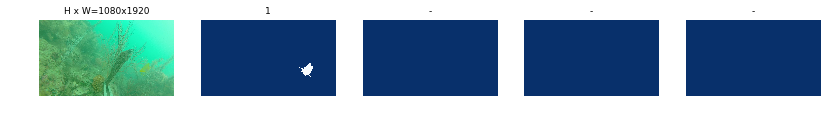

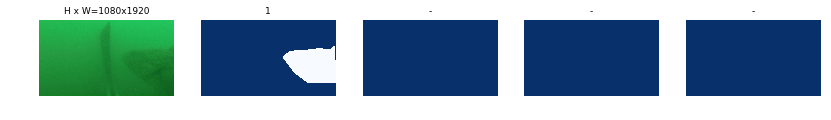

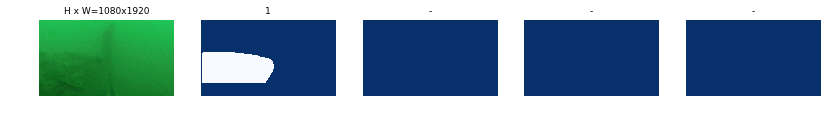

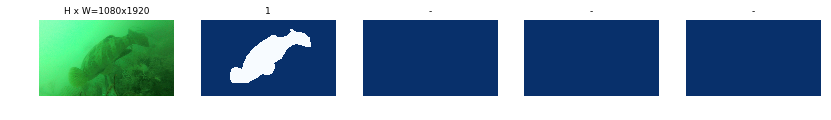

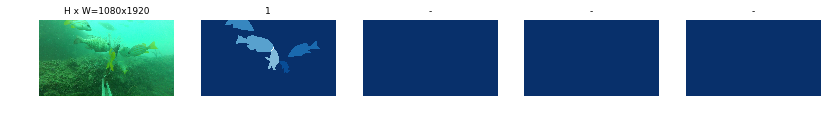

...

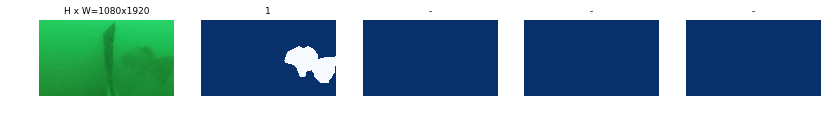

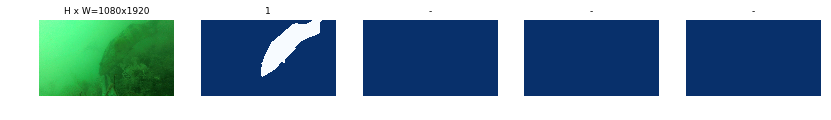

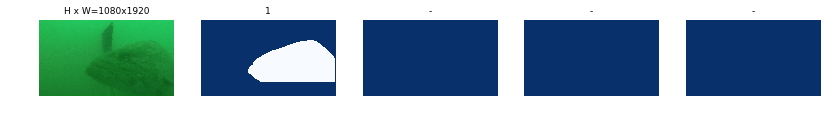

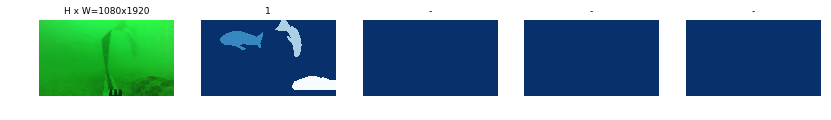

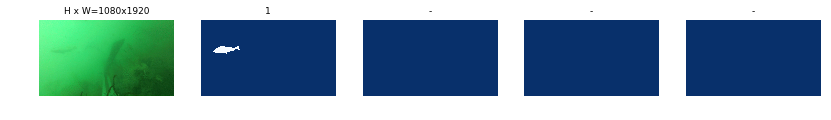

395
Image Count: 395
Class Count: 11
  0. BG                                                
  1. 1                                                 
  2. 2                                                 
  3. 3                                                 
  4. 4                                                 
  5. 5                                                 
  6. 6                                                 
  7. 7                                                 
  8. 8                                                 
  9. 9                                                 
 10. 10                                                


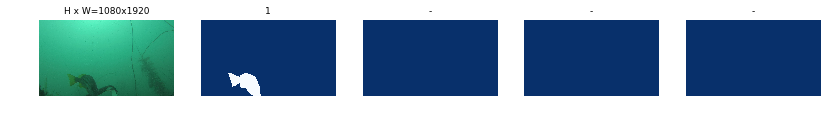

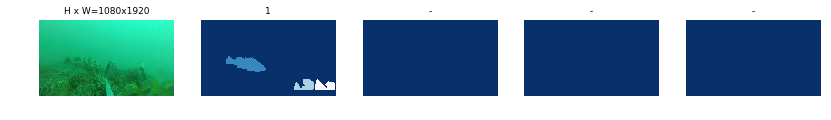

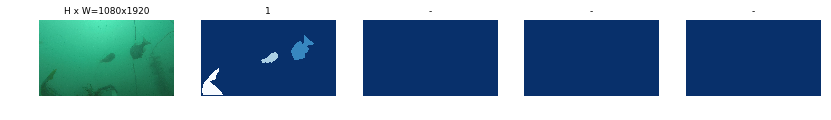

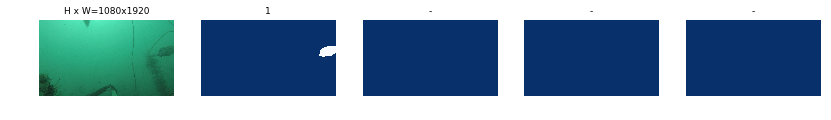

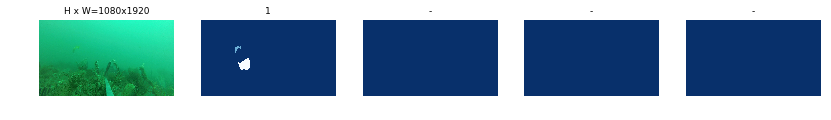

...

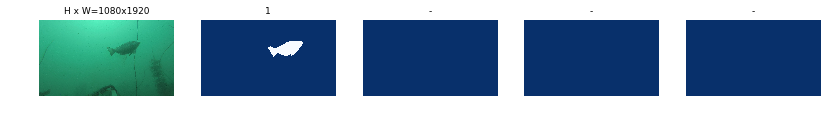

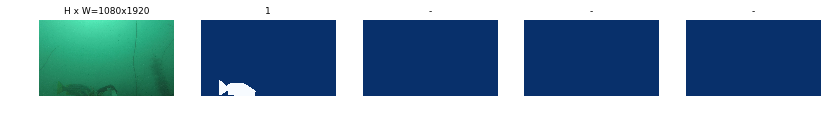

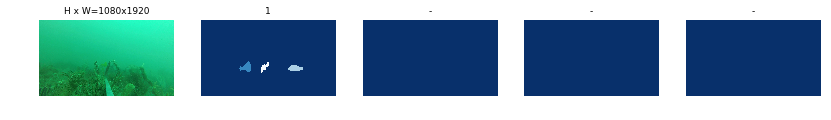

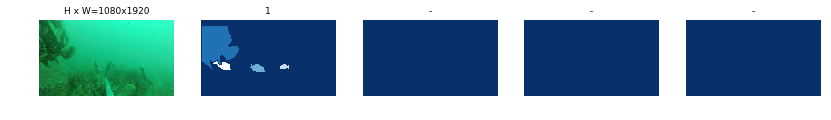

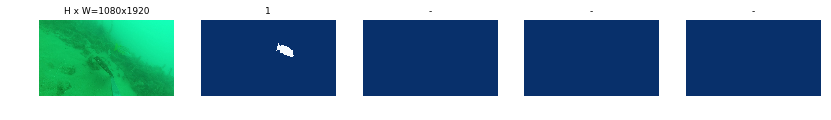

In [12]:
class_names = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']

subsets = ["train", "validate"]

for subset in subsets:
    json_path = os.path.join(dataset_path, subset, 'via_region_data_{0}.json'.format(subset))

    dataset = CustomDataset()
    dataset.load_frames(class_names, dataset_path, subset, json_path)
    dataset.prepare()

    try:
        print("Image Count: {}".format(len(dataset.image_ids)))
        print("Class Count: {}".format(dataset.num_classes))
        for i, info in enumerate(dataset.class_info):
            print("{:3}. {:50}".format(i, info['name']))

        for image_id in dataset.image_ids:
            image = dataset.load_image(image_id)
            mask, class_ids = dataset.load_mask(image_id)
            display_top_masks(image, mask, class_ids, dataset.class_names)
    except AttributeError as attribute_error:
        print(attribute_error)